<a href="https://colab.research.google.com/github/miwojtkowska/open-cv-lessons/blob/master/01_wprowadzenie_kurs_OCV.ipynb" target="_parent"><img src="https://colab.research.google.com/assets/colab-badge.svg" alt="Open In Colab"/></a>

In [0]:
#Import bibliotek
from google.colab import drive
from google.colab.patches import cv2_imshow # patch do plotowania obrazów
import cv2
import imutils
import numpy as np
import pandas as pd

In [0]:
#cv2.__version__ #sprawdzenie wersji opencv
#!pip install opencv-python==4.1.2.30 # zainstalowanie konkretnej wersji
#!pip install -q --upgrade opencv-python # upgrade do najnowszej wersji

'4.1.2'

# Powiązanie Google Drive z Colabem

In [0]:
drive.mount('/content/drive')

Drive already mounted at /content/drive; to attempt to forcibly remount, call drive.mount("/content/drive", force_remount=True).


# Ustawienie katalogu roboczego

In [0]:
cd 'drive/My Drive/open_cv_course'

[Errno 2] No such file or directory: 'drive/My Drive/open_cv_course'
/content/drive/My Drive/open_cv_course


In [0]:
pwd

'/content/drive/My Drive/open_cv_course'

# Podstawowe operacje na obrazie

## Wczytanie obrazu

In [0]:
im_path = 'Obraz1.JPG'
img = cv2.imread(im_path)
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB) #konieczne, żeby wyświetlić obraz przez cv2
#img

## Wyświetlenie obrazu

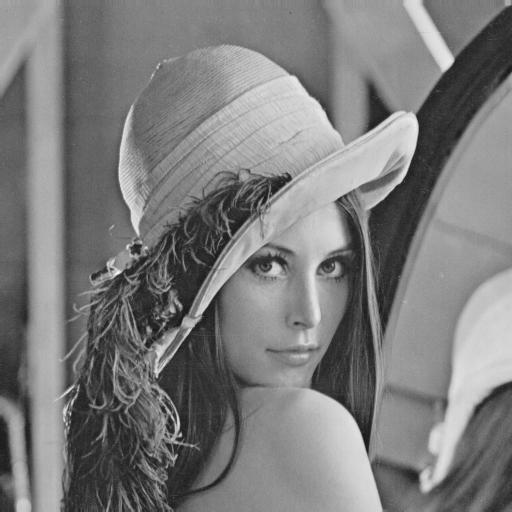

In [0]:
cv2_imshow(img)

In [0]:
# Typ danych
print('typ danych:',img.dtype, '  typ obiektu:', type(img)) # typ danych

typ danych: uint8   typ obiektu: <class 'numpy.ndarray'>


In [0]:
# Rozmiar obrazu
img.shape # 512x512 pix i 3 kanały: RGB

(512, 512, 3)

## Zapis obrazu

In [0]:
# Zapis obrazu w RGB
cv2.imwrite('image1.png', img)

True

## Wczytanie obrazu w skali szarości

In [0]:
img = cv2.imread('Obraz1.JPG', flags = cv2.IMREAD_GRAYSCALE )

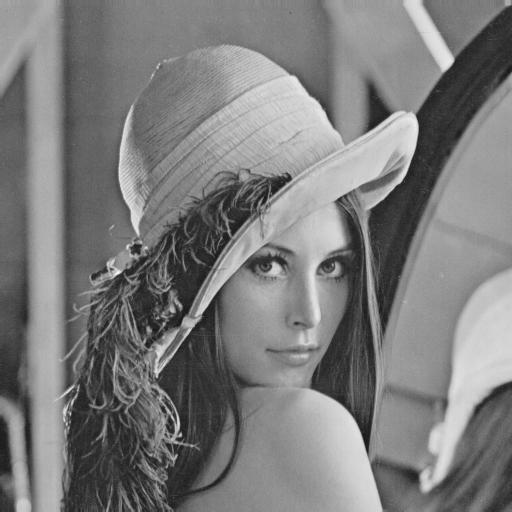

In [0]:
cv2_imshow(img)

In [0]:
# Typ danych
print('typ danych:',img.dtype, '  typ obiektu:', type(img)) # typ danych

typ danych: uint8   typ obiektu: <class 'numpy.ndarray'>


In [0]:
img.shape #obraz jednokanałowy

(512, 512)

## Dodawanie obrazów

In [0]:
img1 = cv2.imread('DJI_08.png')
img2 = cv2.imread('DJI_14.png')

In [0]:
img1 = cv2.cvtColor(img1, cv2.COLOR_BGR2RGB)
img2 = cv2.cvtColor(img2, cv2.COLOR_BGR2RGB)

In [0]:
# Obrazy muszą mieć ten sam rozmiar
img1.shape, img2.shape

((547, 820, 3), (547, 820, 3))

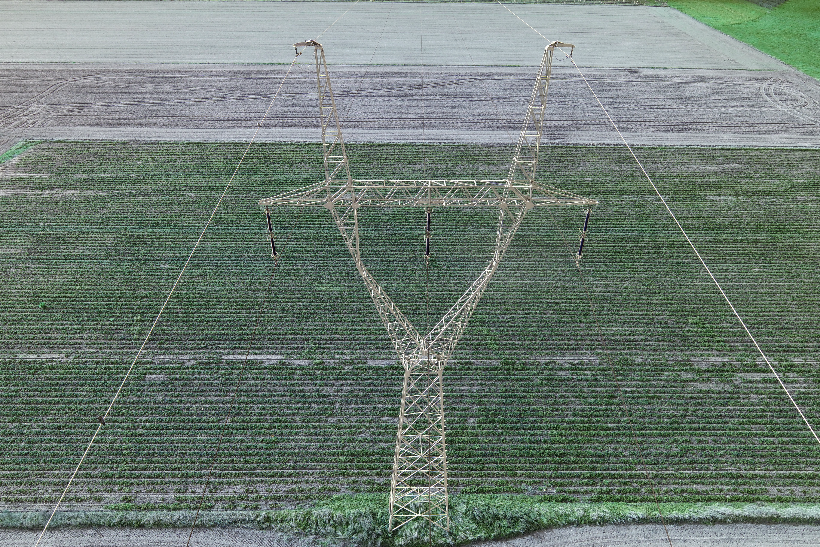

In [0]:
cv2_imshow(img1)

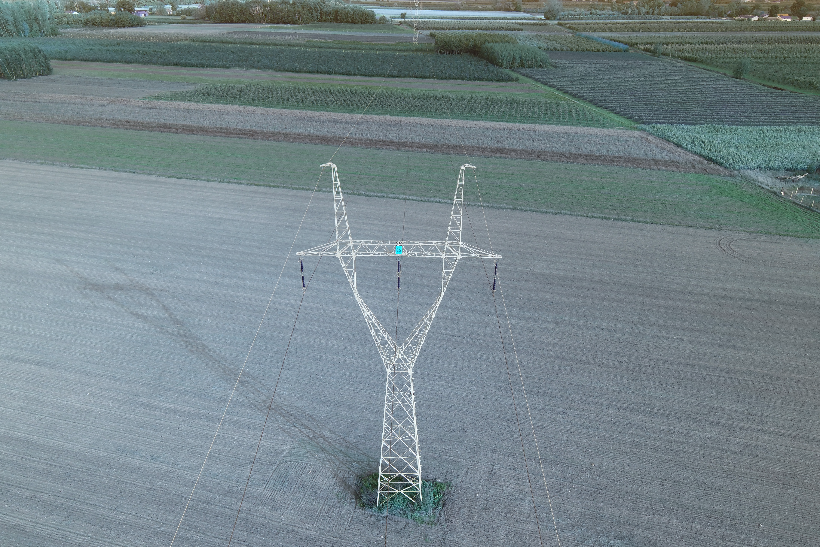

In [0]:
cv2_imshow(img2)

In [0]:
# Dodawanie
sum_of_images = cv2.add(img1, img2)
sum_of_images.shape

(547, 820, 3)

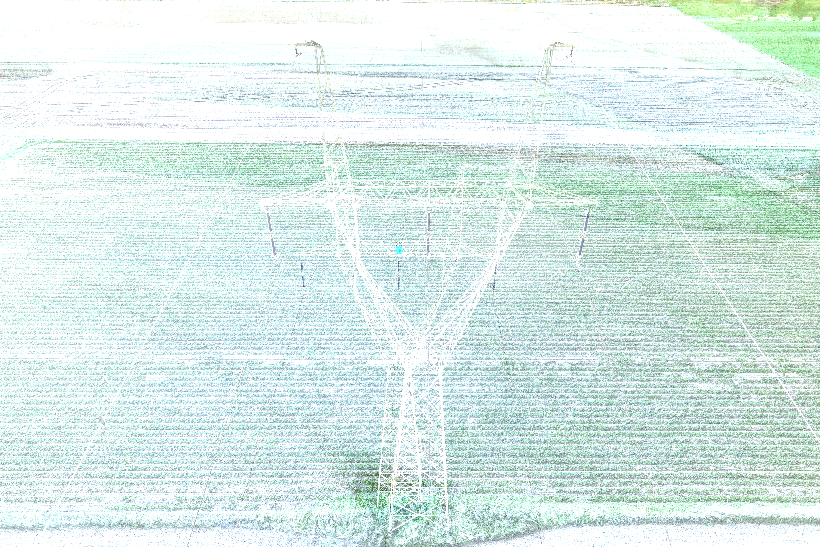

In [0]:
cv2_imshow(sum_of_images)

## Blendowanie

In [0]:
weighted_sum = cv2.addWeighted(src1 = img1, alpha = 0.3, src2 = img2, beta = 0.7, gamma = 0)

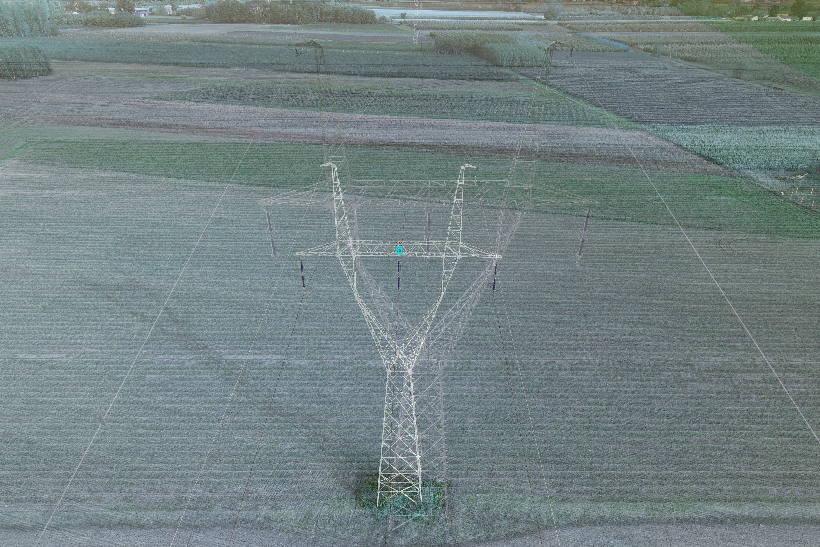

In [0]:
cv2_imshow(weighted_sum)

## Wycinanie fragmentu obrazu

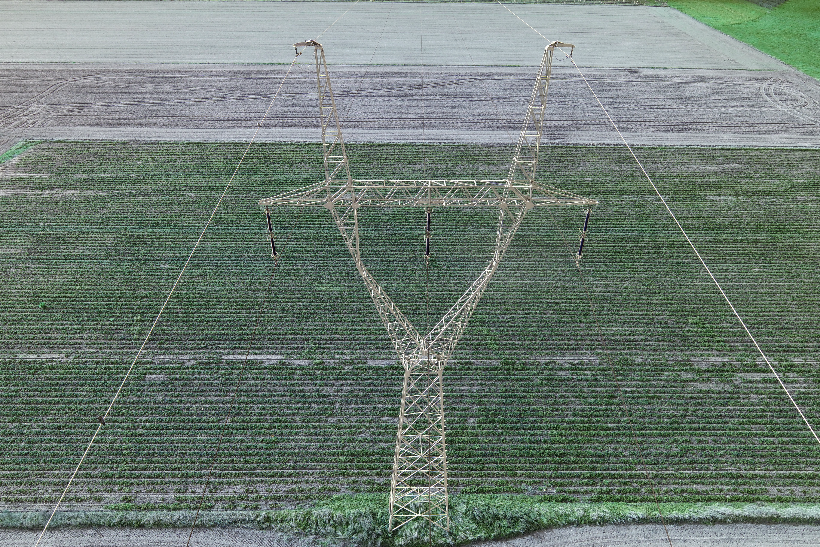

In [0]:
cv2_imshow(img1)

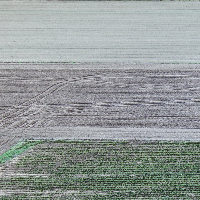

In [0]:
left_top_square = img1[:200, :200]
cv2_imshow(left_top_square)

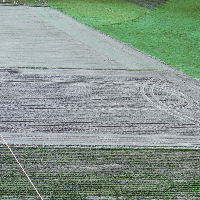

In [0]:
right_top_square = img1[:200:,-200:]
cv2_imshow(right_top_square)

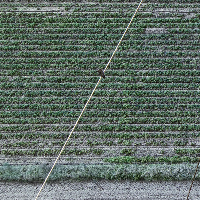

In [0]:
left_bottom_square = img1[-200:,:200]
cv2_imshow(left_bottom_square)

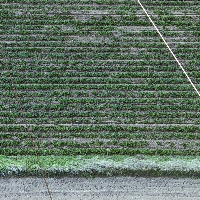

In [0]:
right_bottom_square = img1[-200:,-200:]
cv2_imshow(right_bottom_square)

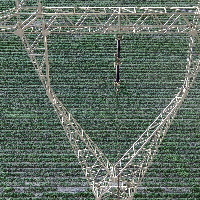

In [0]:
#kwadrat 200 na 200 pikseli wycięty ze środka
a=200
x1 = int(0.5*img1.shape[1]-0.5*a)
x2 = int(0.5*img1.shape[1]+0.5*a)
y1 = int(0.5*img1.shape[0]-0.5*a)
y2 = int(0.5*img1.shape[0]+0.5*a)

middle = img1[y1:y2, x1:x2]
cv2_imshow(middle)

## Modyfikowanie fragmentu obrazu

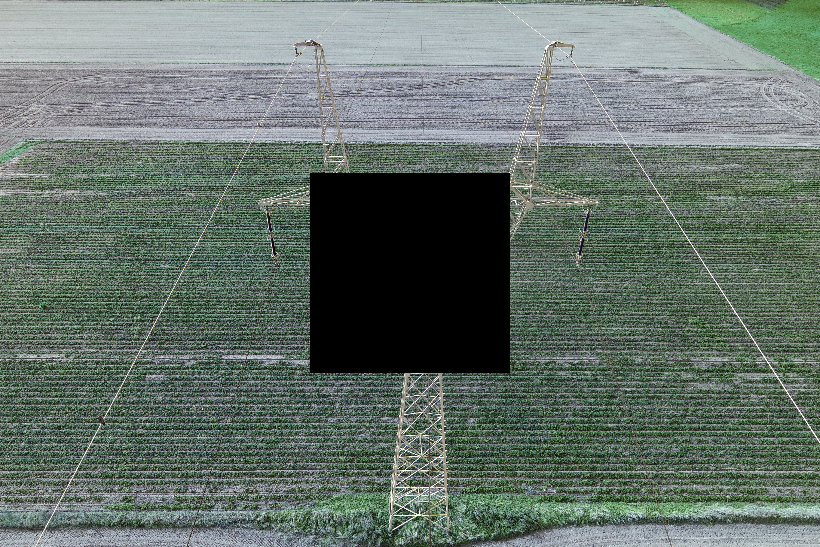

In [0]:
img_copy = img1.copy() 
img_copy[y1:y2, x1:x2] = 0
cv2_imshow(img_copy)

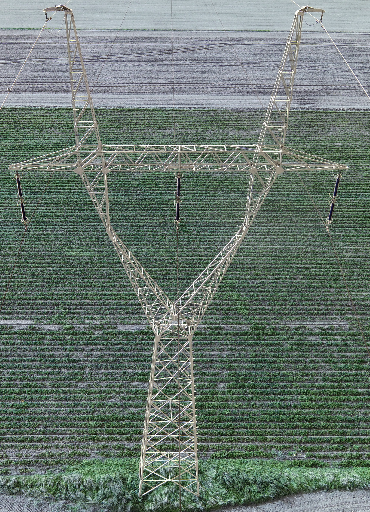

In [0]:
# Wycięcie słupa
slup = img1[35:600, 250:620]
cv2_imshow(slup)


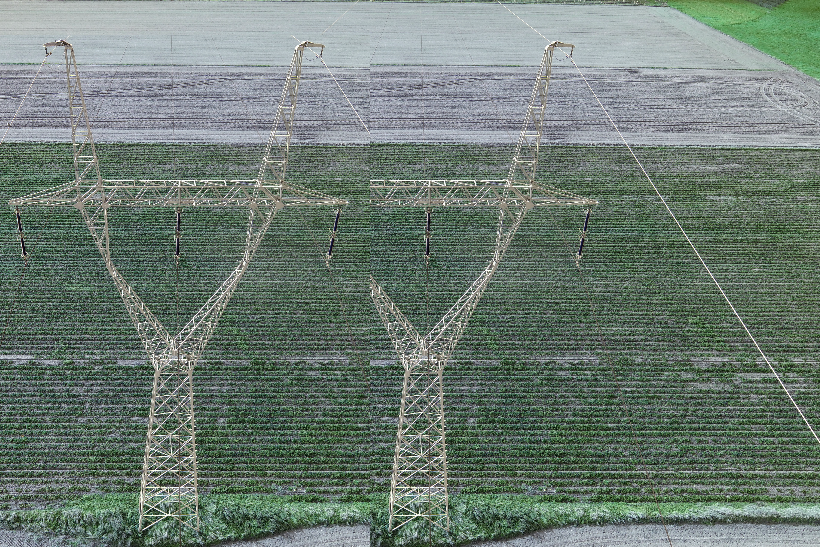

In [0]:
# Wklejenie drugiego słupa
img1_copy = img1.copy() 
img1_copy[35:600, :370] = slup
cv2_imshow(img1_copy)

## Tworzenie obramowania

original_shape: (547, 820, 3) 	new_shape: (647, 920, 3)


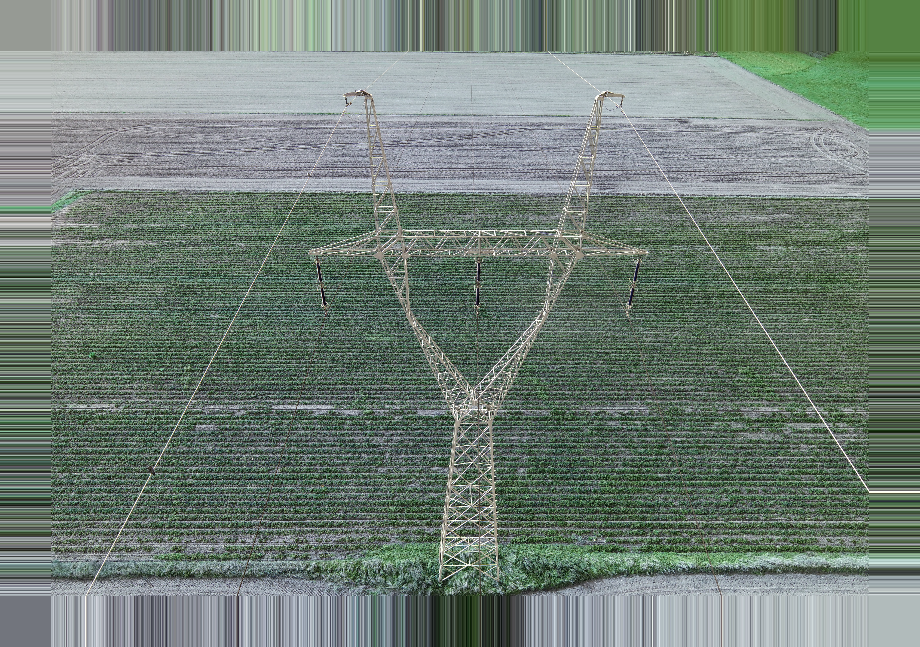

In [0]:
replicate = cv2.copyMakeBorder(img1, top=50, bottom = 50, left = 50, right = 50, borderType = cv2.BORDER_REPLICATE)
print('original_shape:', img1.shape, '\tnew_shape:',replicate.shape )
cv2_imshow(replicate)

original_shape: (547, 820, 3) 	new_shape: (647, 920, 3)


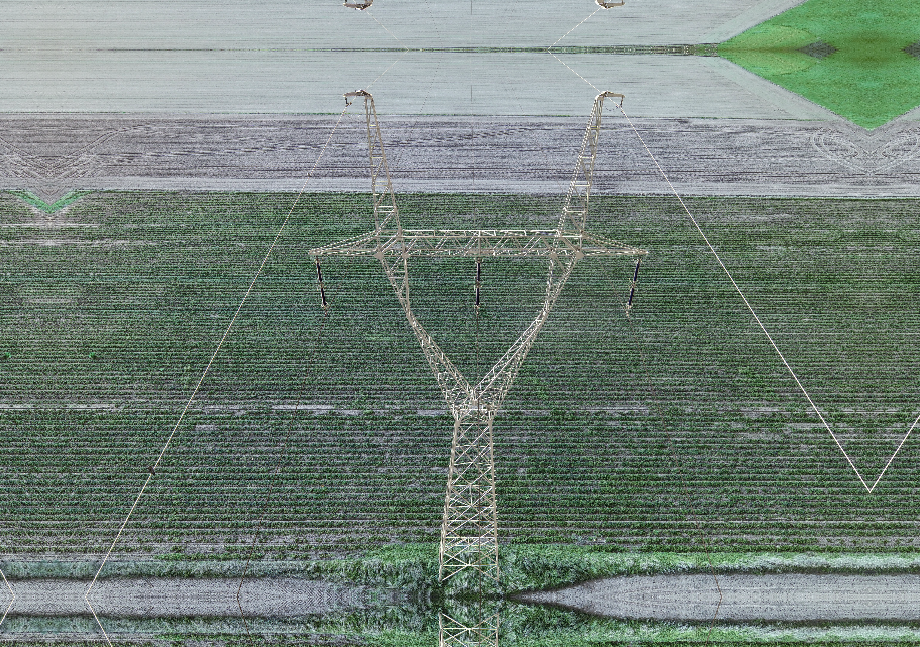

In [0]:
reflect = cv2.copyMakeBorder(img1, top=50, bottom = 50, left = 50, right = 50, borderType = cv2.BORDER_REFLECT)
print('original_shape:', img1.shape, '\tnew_shape:',reflect.shape )
cv2_imshow(reflect)

original_shape: (547, 820, 3) 	new_shape: (647, 920, 3)


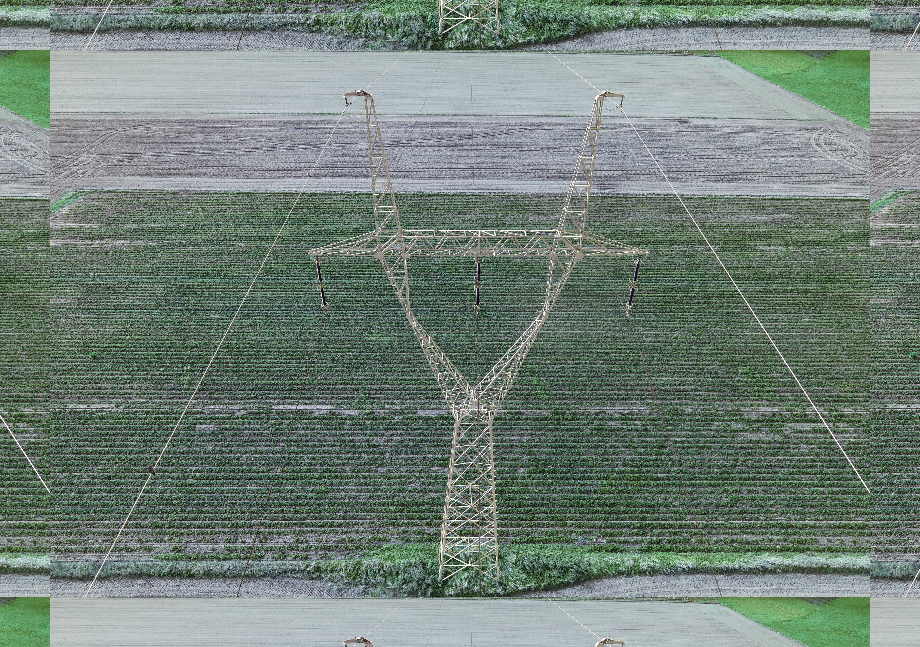

In [0]:
wrap = cv2.copyMakeBorder(img1, top=50, bottom = 50, left = 50, right = 50, borderType = cv2.BORDER_WRAP)
print('original_shape:', img1.shape, '\tnew_shape:',wrap.shape )
cv2_imshow(wrap)

original_shape: (547, 820, 3) 	new_shape: (647, 920, 3)


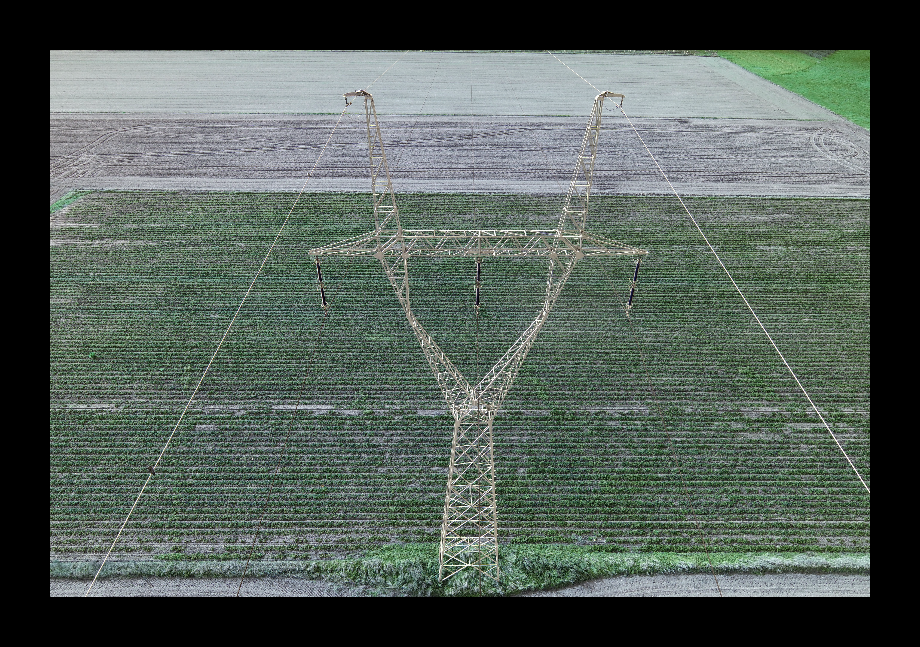

In [0]:
isolated = cv2.copyMakeBorder(img1, top=50, bottom = 50, left = 50, right = 50, borderType = cv2.BORDER_ISOLATED)
print('original_shape:', img1.shape, '\tnew_shape:',isolated.shape )
cv2_imshow(isolated)

## Zmiana rozmiaru zdjęcia

In [0]:
img = cv2.imread('DJI_08.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print('img_shape:',img.shape)

img_shape: (547, 820, 3)


img_shape: (200, 299, 3)


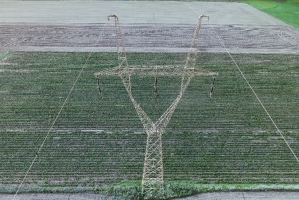

In [0]:
img_resized = imutils.resize(img, height=200) # Przeskalowanie do określonej wysokości
print('img_shape:',img_resized.shape)
cv2_imshow(img_resized)

img_shape: (66, 100, 3)


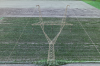

In [0]:
img_resized = imutils.resize(img, width=100) # Przeskalowanie do określonej szerokości
print('img_shape:',img_resized.shape)
cv2_imshow(img_resized)

## Obrót obrazu

In [0]:
img = cv2.imread('DJI_08.png')
img = cv2.cvtColor(img, cv2.COLOR_BGR2RGB)
print('img_shape:',img.shape)

img_shape: (547, 820, 3)


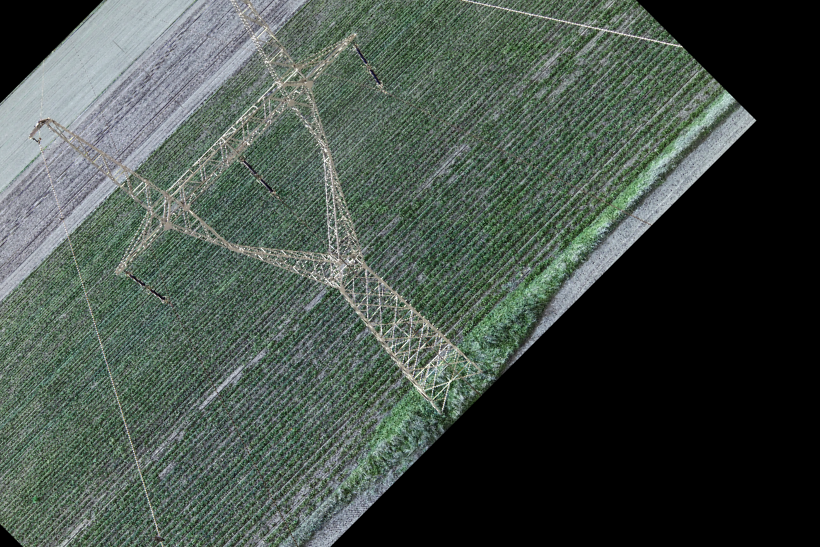

In [0]:
# Definicja macierzy rotacji
height, width = img1.shape[:2]
M = cv2.getRotationMatrix2D(center = (height // 2, width //2), angle=45, scale=1)
# Transformacja
rotated = cv2.warpAffine(img1, M, dsize=(width, height))
cv2_imshow(rotated)

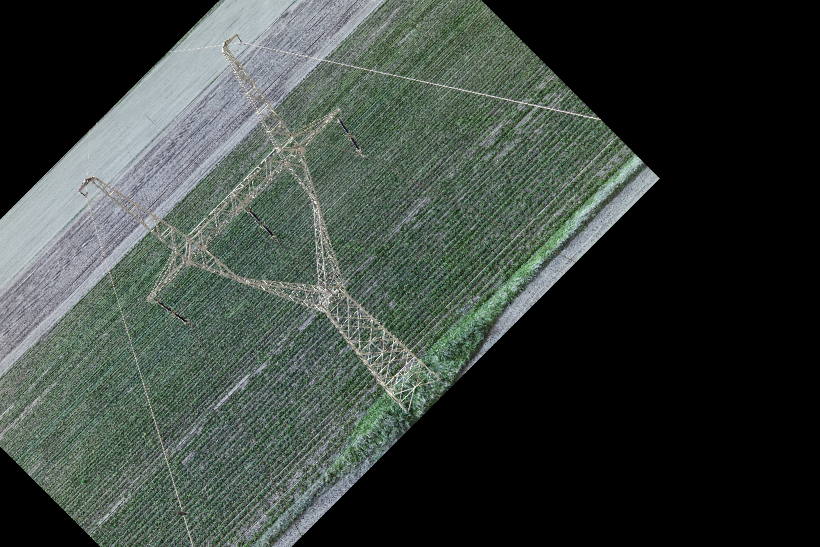

In [0]:
M = cv2.getRotationMatrix2D(center = (height // 2, width //2), angle=45, scale=0.8)
# Transformacja
rotated = cv2.warpAffine(img1, M, dsize=(width, height))
cv2_imshow(rotated)

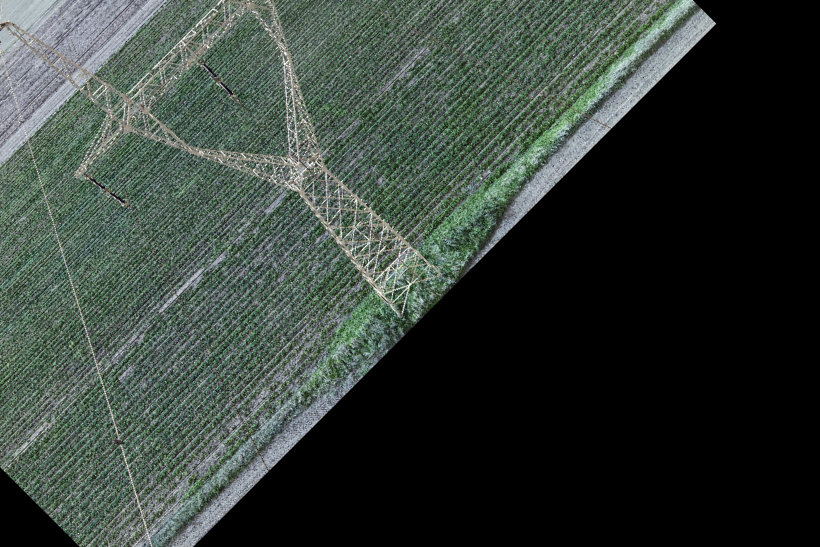

In [0]:
M = cv2.getRotationMatrix2D(center = (height // 4, width //2), angle=45, scale=1)
# Transformacja
rotated = cv2.warpAffine(img1, M, dsize=(width, height))
cv2_imshow(rotated)

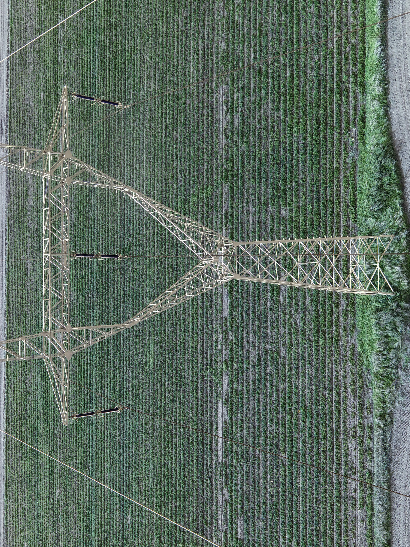

In [0]:
M = cv2.getRotationMatrix2D(center = (height // 2, width //2), angle=90, scale=1)
# Transformacja
rotated = cv2.warpAffine(img1, M, dsize=(width//2, height))
cv2_imshow(rotated)

# Progowanie

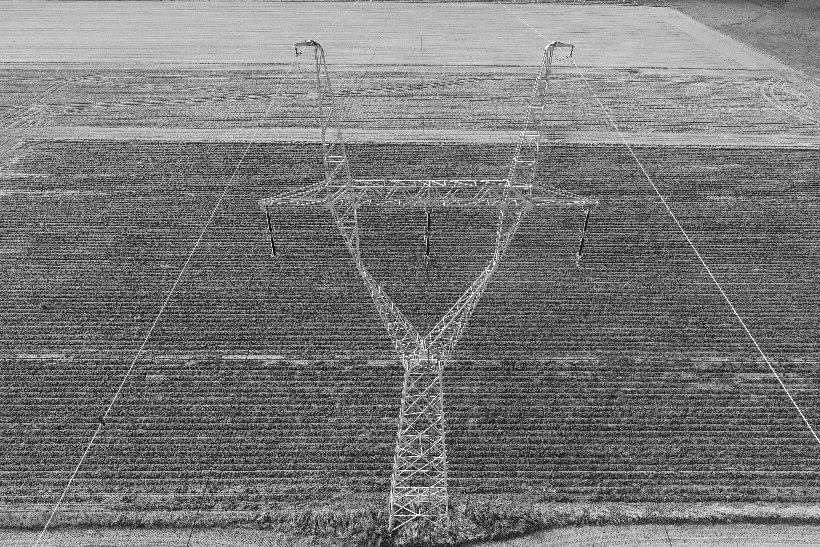

In [0]:
gray = cv2.imread('DJI_08.png', flags = cv2.IMREAD_GRAYSCALE)
cv2_imshow(gray)

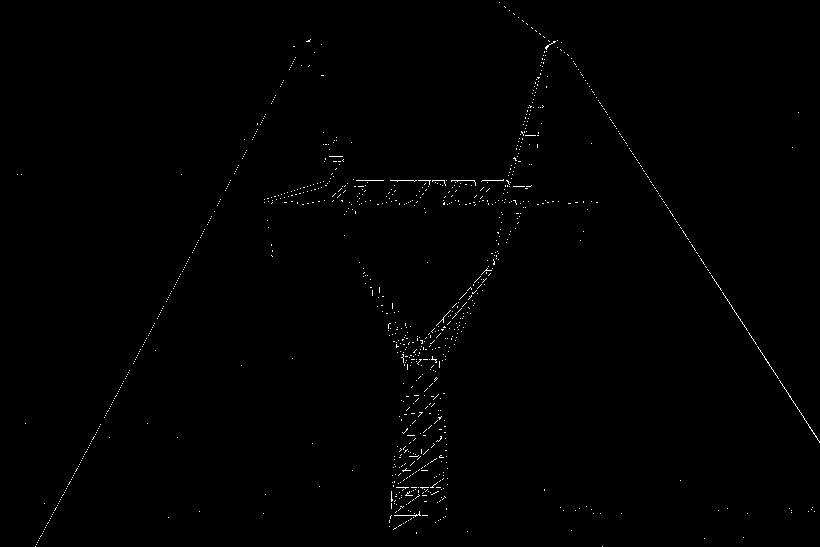

In [0]:
# Progowanie
thresh = cv2.threshold(gray, thresh = 230, maxval = 255, type=cv2.THRESH_BINARY)[1]
cv2_imshow(thresh)

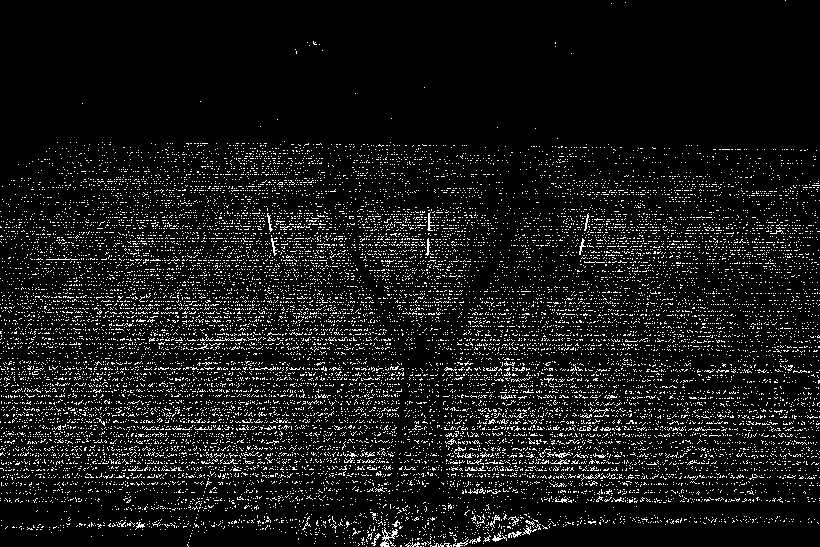

In [0]:
# Progowanie
thresh = cv2.threshold(gray, thresh = 50, maxval = 255, type=cv2.THRESH_BINARY_INV)[1]
cv2_imshow(thresh)

# Splot funkcji